In [1]:
# ETHAN COLE
# Please feel free to adapt and work on this, just copy to a different directory.

In [1]:
#Above we have a dataset that is in Kelvin, we need to subtract 273.15 from each temperature value in order to get it into Celsius.
import plotly.graph_objects as go
import pandas as pd

# Define column names
columns = ['year', 'month', 'day', 'hour', 'temperature', 'precipitation', 'u-wind', 'v-wind']

# Load data from CSV without headers
data = pd.read_csv("17.36N_78.5E.csv", names=columns)
data['temperature'] -= 273.15

# Extract timestamps and temperature values
timestamps = pd.to_datetime(data[['year', 'month', 'day', 'hour']])
temperature = data['temperature']
# Create plotly figure
fig = go.Figure()
# Add temperature trace
fig.add_trace(go.Scatter(x=timestamps, y=temperature, mode='lines', name='Temperature'))
# Update layout
fig.update_layout(title='Temperature Fluctuations Over Time',
                   xaxis_title='Time',
                   yaxis_title='Temperature/C')

# Show plot
fig.show()


In [2]:
#So I want to use scikit learn's MLP regressor model to predict temperature 
import pandas as pd
from IPython.display import display
# Define column names
columns = ['year', 'month', 'day', 'hour', 'temperature', 'precipitation', 'u-wind', 'v-wind']

# Load data from CSV without headers
df = pd.read_csv("17.36N_78.5E.csv", names=columns) #Here we are only choosing one of the CSV files, 
                                                            #this can be expanded to make use of the full data set
df['temperature'] -= 273.15
#Now I have the dataset loaded and the temperature adjusted to celcius
df

,year,month,day,hour,temperature,precipitation,u-wind,v-wind
0,1980,1,1,0,17.59,0.0,-0.063355,2.81810
1,1980,1,1,1,17.69,0.0,0.038482,2.43180
2,1980,1,1,2,18.79,0.0,0.538340,2.22210
3,1980,1,1,3,23.40,0.0,1.049000,2.27480
4,1980,1,1,4,24.29,0.0,1.115400,2.75550
...,...,...,...,...,...,...,...,...
341875,2018,12,31,19,17.60,0.0,-1.388800,0.93791
341876,2018,12,31,20,17.70,0.0,-0.838810,0.99260
341877,2018,12,31,21,17.43,0.0,-0.669240,0.78582
341878,2018,12,31,22,15.64,0.0,-0.513420,0.40313


In [68]:
from os import walk
#Coordinate conversion

coordinateFilenames = next(walk("C:/Users/ethan/OneDrive/Desktop/ThirdYear/Applied DataScience/Coursework/Data/"), (None, None, []))[2]  # [] if no file
print(coordinateFilenames)
for i in range(len(coordinateFilenames)):
    coordinateFilenames[i] = coordinateFilenames[i].replace('.csv', '')
print(coordinateFilenames)

['-33.5N_151E.csv', '-33.9N_18.5E.csv', '17.36N_78.5E.csv', '18N_283.2E.csv', '40.75N_286.01E.csv', '41.9N_12.46E.csv', '43.28N_5.39E.csv', '43.64N_280.63E.csv', '51.03N_245.94E.csv', '51.5N_359.9E.csv', '58.76N_265.83E.csv', '59.92N_10.75E.csv']
['-33.5N_151E', '-33.9N_18.5E', '17.36N_78.5E', '18N_283.2E', '40.75N_286.01E', '41.9N_12.46E', '43.28N_5.39E', '43.64N_280.63E', '51.03N_245.94E', '51.5N_359.9E', '58.76N_265.83E', '59.92N_10.75E']


In [3]:
num_rows = df.shape[0]
def checkForOutliers(column):
    print("Checking:"+column)
    # calculate IQR for column Height
    Q1 = df[column].quantile(0.1)
    Q3 = df[column].quantile(0.9)
    IQR = Q3 - Q1

    # identify outliers
    threshold = 1.5
    outliers = df[(df[column] < Q1 - threshold * IQR) | (df[column] > Q3 + threshold * IQR)]
    print(str((len(outliers)/num_rows)*100)+"% are considerd outliers by this definition.")
    print(outliers[column])
    print("\n")
    print("\n")

#Checks the 10th and 90th percentiles of the data to identify extreme/incorrect values.
checkForOutliers('temperature')
checkForOutliers('precipitation')
checkForOutliers('u-wind')
checkForOutliers('v-wind')
#Only Ones that come up are the precipitation, which are likely influenced by the 30% of the precipitation records that have the value zero.
num_zeros = (df['precipitation'] == 0).sum()
print("Number of zeros:", num_zeros/num_rows)

Checking:temperature
0.0% are considerd outliers by this definition.
Series([], Name: temperature, dtype: float64)




Checking:precipitation
6.411021411021411% are considerd outliers by this definition.
1715      0.000809
1737      0.000492
1738      0.000951
1763      0.000726
2219      0.000612
            ...   
339611    0.001022
339635    0.000836
341534    0.000698
341535    0.000564
341536    0.000488
Name: precipitation, Length: 21918, dtype: float64




Checking:u-wind
0.0% are considerd outliers by this definition.
Series([], Name: u-wind, dtype: float64)




Checking:v-wind
0.0% are considerd outliers by this definition.
Series([], Name: v-wind, dtype: float64)




Number of zeros: 0.33374283374283376


In [4]:
#This cell just trims the entire dataframe down to make testing faster, here we take the first 20% of the rows...
import numpy as np
percentage = 1  # What percentage of the dataframe should be included
df_top = df[(df.index > np.percentile(df.index, 100-(percentage*10)))]
num_rows = len(df)
top_rows = int(num_rows * percentage)
df_top = df.head(top_rows)
df = df_top
df

,year,month,day,hour,temperature,precipitation,u-wind,v-wind
0,1980,1,1,0,17.59,0.0,-0.063355,2.81810
1,1980,1,1,1,17.69,0.0,0.038482,2.43180
2,1980,1,1,2,18.79,0.0,0.538340,2.22210
3,1980,1,1,3,23.40,0.0,1.049000,2.27480
4,1980,1,1,4,24.29,0.0,1.115400,2.75550
...,...,...,...,...,...,...,...,...
341875,2018,12,31,19,17.60,0.0,-1.388800,0.93791
341876,2018,12,31,20,17.70,0.0,-0.838810,0.99260
341877,2018,12,31,21,17.43,0.0,-0.669240,0.78582
341878,2018,12,31,22,15.64,0.0,-0.513420,0.40313


In [5]:
import pandas as pd
#This cell produces new one-hot encoded values from the date columns, classifying them as seasons, times of day
#We also make the day of week cyclic, classifying them to monday,tuesday,wednesday... as numbers 0-6

print(df['hour'].unique())
# Assuming df is your dataframe
df['datetime'] = pd.to_datetime(df[['year', 'month', 'day', 'hour']])
df['season'] = df['datetime'].dt.month // 3 + 1  # Divide months into seasons

df['time_of_day'] = pd.cut(df['hour'], bins=[-1, 6, 12, 18, 24], labels=[0, 1, 2, 3]) # 0,1,2,3 represent night,morning,afternoon,evening
# df['day_of_week'] = df['datetime'].dt.day_of_week
df['time_since_start'] = (df['datetime'] - df['datetime'].min()).dt.days
df.drop(columns=['datetime'], inplace=True)


[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]


C:\Users\ethan\AppData\Local\Temp\ipykernel_2080\2577349947.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ethan\AppData\Local\Temp\ipykernel_2080\2577349947.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ethan\AppData\Local\Temp\ipykernel_2080\2577349947.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

In [6]:
#Optionally perform PCA dimensionality reduction or other preprocessing here...

In [7]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
# Split data into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(
    df.drop(columns=['temperature']),  # Features (X)
    df['temperature'],  # Target variable (y)
    test_size=0.2,  # 20% for test set
    random_state=1  # For reproducibility
)

# Further split the train set into train and validation sets (60% train, 20% validation)
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train,
    test_size=0.25,  # 20% for validation set (0.25 * 0.8 = 0.2)
    random_state=1  # For reproducibility
)

# Now you have X_train, y_train (for training),
# X_val, y_val (for validation), and
# X_test, y_test (for testing)
display(X_train) # X_train contains our data values excluding temperature
display(y_train) # y_train is our target variable dataframe

,year,month,day,hour,precipitation,u-wind,v-wind,season,time_of_day,day_of_week,time_since_start
69269,1987,11,26,5,-1.862600e-09,-1.50940,-0.97193,4,0,3,2886
247217,2008,3,14,17,0.000000e+00,-0.80593,1.74080,2,2,4,10300
132480,1995,2,11,0,-3.725300e-09,0.98948,0.97223,1,0,5,5520
67705,1987,9,22,1,-1.862600e-09,2.28340,-1.35680,4,0,1,2821
230650,2006,4,24,10,0.000000e+00,0.34947,-1.15140,2,1,0,9610
...,...,...,...,...,...,...,...,...,...,...,...
136241,1995,7,17,17,1.472800e-03,3.66700,2.52310,3,2,0,5676
177909,2000,4,17,21,0.000000e+00,0.67546,3.56780,2,3,0,7412
194252,2002,2,27,20,-1.862600e-09,-1.06020,1.99010,1,3,2,8093
307344,2015,1,23,0,0.000000e+00,-1.13520,1.73120,1,0,4,12806


69269     26.55
247217    26.06
132480    17.03
67705     27.40
230650    38.95
          ...  
136241    25.57
177909    29.85
194252    22.27
307344    19.95
1612      28.95
Name: temperature, Length: 205128, dtype: float64

In [8]:
#Check for not a number values:
nan_values = df.isna()
print(nan_values.sum())
display(df['time_of_day'])
nan_values = df['time_of_day'].isna()
print(nan_values)
display(df['time_of_day'].unique())

year                0
month               0
day                 0
hour                0
temperature         0
precipitation       0
u-wind              0
v-wind              0
season              0
time_of_day         0
day_of_week         0
time_since_start    0
dtype: int64


0         0
1         0
2         0
3         0
4         0
         ..
341875    3
341876    3
341877    3
341878    3
341879    3
Name: time_of_day, Length: 341880, dtype: category
Categories (4, int64): [0 < 1 < 2 < 3]

0         False
1         False
2         False
3         False
4         False
          ...  
341875    False
341876    False
341877    False
341878    False
341879    False
Name: time_of_day, Length: 341880, dtype: bool


[0, 1, 2, 3]
Categories (4, int64): [0 < 1 < 2 < 3]

In [9]:
# Create an MLPRegressor with one hidden layer of 100 neurons
model = MLPRegressor(hidden_layer_sizes=(128, 64, 32, 16, 8), activation='relu', solver='adam', max_iter=1, verbose=False,  early_stopping=False)

# Fit the model to your training data
model.fit(X_train, y_train)


c:\Users\ethan\anaconda3\envs\ScikitLearn\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (1) reached and the optimization hasn't converged yet.



MLPRegressor(hidden_layer_sizes=(128, 64, 32, 16, 8), max_iter=1)

In [10]:
#Save the model locally to retain progress.
# from sklearn.externals import joblib
import joblib
import numpy as np
joblib.dump(model, 'bestFullDataModel.pkl')

['bestFullDataModel.pkl']

In [36]:

# This cell loads the saved model, and then you can continuously retrain it to get a lower loss score.
#Can also use this cell to apply a larger training set to the model, and perform transform training - utilising the existing weights but expanding the model.
# loaded_model = joblib.load('mlp_regressor_model.pkl')
# # Continue training the loaded model
# loaded_model.partial_fit(X_train, y_train)
from sklearn.metrics import mean_squared_error
import joblib
import numpy as np
loaded_model = joblib.load('mlp_regressor_model.pkl')

epochs_without_improvement = 0
# best_validation_loss = np.inf
best_validation_loss = 3.5999927235840734

bestModel = loaded_model
for epoch in range(100):  # Train for a maximum of 100 epochs
    loaded_model.partial_fit(X_train, y_train)
    print("Epoch: "+str(epoch)+" Training Loss="+ str(loaded_model.loss_))
    # Evaluate validation loss periodically
    validation_loss = mean_squared_error(y_val, loaded_model.predict(X_val))
    if validation_loss < best_validation_loss:
        best_validation_loss = validation_loss
        bestModel = loaded_model
        epochs_without_improvement = 0
        print("New Val Loss: "+ str(validation_loss))
    else:
        epochs_without_improvement += 1
        
    # Check if validation loss hasn't improved for 10 consecutive epochs
    if epochs_without_improvement >= 100:
        print("Stopping training. Validation loss did not improve for 100 consecutive epochs.")
        break

print("Re-saving partial fit model")
print("Best validation loss: "+ str(best_validation_loss))
joblib.dump(bestModel, 'mlp_regressor_model.pkl')


Iteration 1, loss = 1.85334090
Epoch: 0 Training Loss=1.8533408974355585
Iteration 1, loss = 1.87012066
Epoch: 1 Training Loss=1.8701206590843815
Iteration 1, loss = 1.87022783
Epoch: 2 Training Loss=1.870227830584845
New Val Loss: 3.587442917961093
Iteration 1, loss = 1.86561585
Epoch: 3 Training Loss=1.8656158496084454
Iteration 1, loss = 1.86270917
Epoch: 4 Training Loss=1.8627091665783875
Iteration 1, loss = 1.86642811
Epoch: 5 Training Loss=1.8664281108429108
Iteration 1, loss = 1.86865514
Epoch: 6 Training Loss=1.868655142142071
Iteration 1, loss = 1.86964675
Epoch: 7 Training Loss=1.8696467506565444
New Val Loss: 3.584741281300217
Iteration 1, loss = 1.85703134
Epoch: 8 Training Loss=1.8570313366796125
Iteration 1, loss = 1.86964914
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Epoch: 9 Training Loss=1.8696491369492847
Iteration 1, loss = 1.84438756
Epoch: 10 Training Loss=1.8443875591384846
Iteration 1, loss = 1.86315442
Epoch: 11 Tra

['mlp_regressor_model.pkl']

In [27]:
print("Best training loss: "+ str(bestModel.loss_))
print("Best training loss: "+ str(best_validation_loss))


Best training loss: 2.065578614227974
Best training loss: 3.9027443592912485


In [28]:
model = joblib.load('mlp_regressor_model.pkl') #Loads in the locally trained best model.

In [29]:
#Predicting values over my test set...
y_pred = model.predict(X_test)

In [30]:
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(y_test, y_pred) #best achieved: 3.37 = +-1.83
print(f"Mean Squared Error: {mse:.2f}")


Mean Squared Error: 4.71


In [31]:
df_results = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred, 'Residuals':(abs(y_test-y_pred))})
display(df_results.head())
print()
from sklearn.metrics import r2_score
score = r2_score(y_test, y_pred)
print("The r2 score of our model is {}%".format(round(score, 5) *100))

,Actual,Predicted,Residuals
207134,27.03,27.871600,0.841600
279426,21.47,23.064836,1.594836
214576,31.42,29.021171,2.398829
273836,23.81,29.663321,5.853321
97966,23.54,24.038025,0.498025



The r2 score of our model is 85.735%


,Actual,Predicted,Date
207134,27.03,27.871600,2003-08-18
279426,21.47,23.064836,2011-11-16
214576,31.42,29.021171,2004-06-23
273836,23.81,29.663321,2011-03-28
97966,23.54,24.038025,1991-03-05


Actual                      8.12
Predicted              12.651465
Date         1980-01-01 00:00:00
dtype: object
Actual                     45.92
Predicted              45.670622
Date         2018-12-31 00:00:00
dtype: object


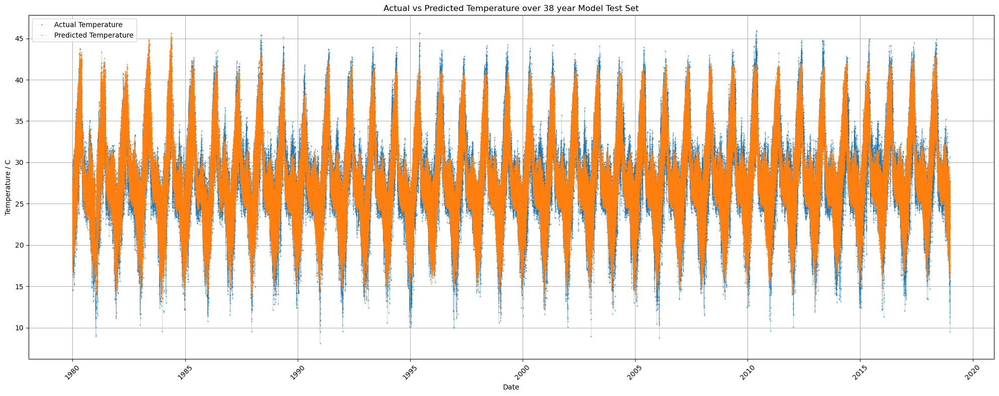

The r2 score of our model over the 38 year subset is 85.735%
Mean Squared Error: 4.71
Actual                      8.12
Predicted              12.651465
Date         1980-01-01 00:00:00
dtype: object
Actual                     45.92
Predicted              45.670622
Date         2018-12-31 00:00:00
dtype: object


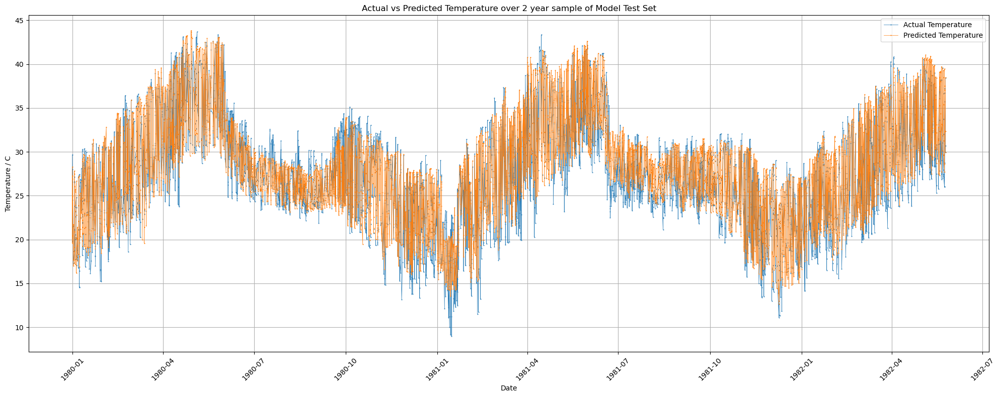

The r2 score of our model over the one year subset is 89.179%
Mean Squared Error: 3.76


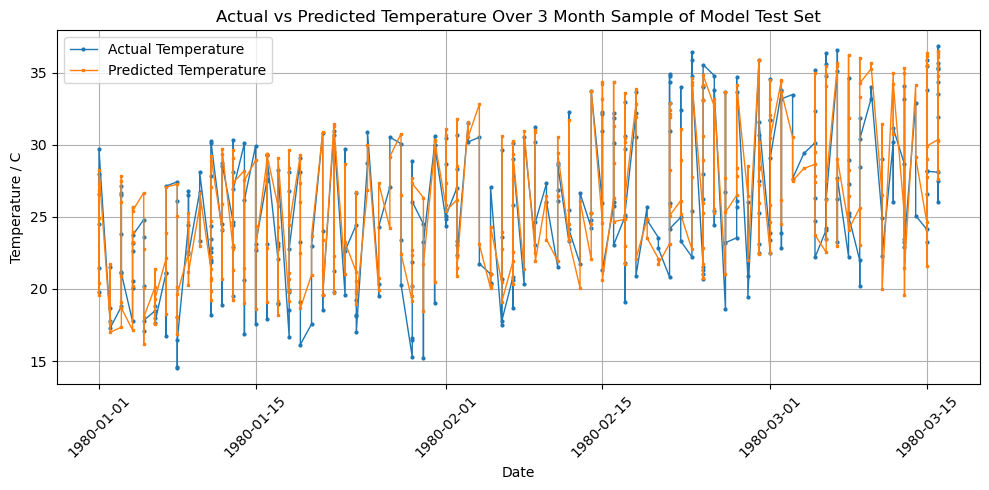

The r2 score of our model over the 3 month subset is 88.824%
Mean Squared Error: 3.09


In [41]:
# import matplotlib as plt
import plotly.graph_objects as go
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
df_results = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred, 'Date':pd.to_datetime(X_test[['year', 'month', 'day']])})
display(df_results.head())
df_results = df_results.sort_values(by='Date')
df_results = df_results.head(int(1*len(df_results)))
print(df_results.min())
print(df_results.max())

# Plot the temperatures
plt.figure(figsize=(20, 8))
plt.plot(df_results['Date'], df_results['Actual'], label='Actual Temperature', marker='o', markersize=0.5, linewidth = 0.1)
plt.plot(df_results['Date'], df_results['Predicted'], label='Predicted Temperature', marker='s', markersize=0.5, linewidth=0.1)
plt.xlabel('Date')
plt.ylabel('Temperature / C')
plt.title('Actual vs Predicted Temperature over 38 year Model Test Set')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
score = r2_score(df_results['Actual'], df_results['Predicted'])
print("The r2 score of our model over the 38 year subset is {}%".format(round(score, 5) *100))
mse = mean_squared_error(df_results['Actual'], df_results['Predicted']) #best achieved: 3.37 = +-1.83
print(f"Mean Squared Error: {mse:.2f}")


df_results = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred, 'Date':pd.to_datetime(X_test[['year', 'month', 'day']])})
# display(df_results.head())
df_results = df_results.sort_values(by='Date')
print(df_results.min())
print(df_results.max())
df_results = df_results.head(int((1/16)*len(df_results)))

# Plot the temperatures
plt.figure(figsize=(20, 8))
plt.plot(df_results['Date'], df_results['Actual'], label='Actual Temperature', marker='o', markersize=0.5, linewidth = 0.5)
plt.plot(df_results['Date'], df_results['Predicted'], label='Predicted Temperature', marker='s', markersize=0.5, linewidth=0.5)
plt.xlabel('Date')
plt.ylabel('Temperature / C')
plt.title('Actual vs Predicted Temperature over 2 year sample of Model Test Set')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
score = r2_score(df_results['Actual'], df_results['Predicted'])
print("The r2 score of our model over the one year subset is {}%".format(round(score, 5) *100))
mse = mean_squared_error(df_results['Actual'], df_results['Predicted']) #best achieved: 3.37 = +-1.83
print(f"Mean Squared Error: {mse:.2f}")

df_results = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred, 'Date':pd.to_datetime(X_test[['year', 'month', 'day']])})
# display(df_results.head())
df_results = df_results.sort_values(by='Date')
df_results = df_results.head(int(((1/192))*len(df_results)))
# print(df_results.min())
# print(df_results.max())

# Plot the temperatures
plt.figure(figsize=(10, 5))
plt.plot(df_results['Date'], df_results['Actual'], label='Actual Temperature', marker='o', markersize=2, linewidth = 1)
plt.plot(df_results['Date'], df_results['Predicted'], label='Predicted Temperature', marker='s', markersize=2, linewidth=1)
plt.xlabel('Date')
plt.ylabel('Temperature / C')
plt.title('Actual vs Predicted Temperature Over 3 Month Sample of Model Test Set')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#R2 of 1 indicaites the model predicts 100% of the relationship.
#R² = 1 - RSS/TSS
# R² = coefficient of determination
# RSS = sum of squares of residuals
# TSS = total sum of squares
#SO R2 is the mean of the square of the residuals 


score = r2_score(df_results['Actual'], df_results['Predicted'])
print("The r2 score of our model over the 3 month subset is {}%".format(round(score, 5) *100))
mse = mean_squared_error(df_results['Actual'], df_results['Predicted']) #best achieved: 3.37 = +-1.83
print(f"Mean Squared Error: {mse:.2f}")

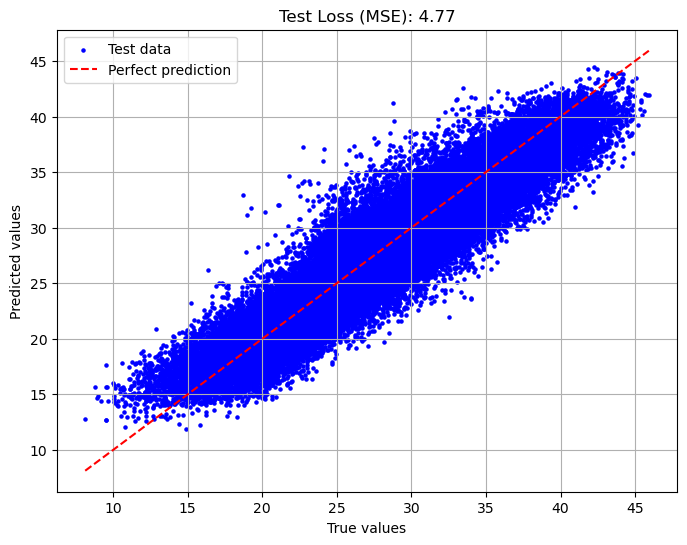

In [18]:
import matplotlib.pyplot as plt
test_loss = mean_squared_error(y_test, y_pred)

# Plot test loss
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='blue', label='Test data', s = 5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect prediction')
plt.title('Test Loss (MSE): {:.2f}'.format(test_loss))
plt.xlabel('True values')
plt.ylabel('Predicted values')
plt.legend()
plt.grid(True)
plt.show()

In [19]:

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Calculate mean squared error for training and testing data
train_loss = mean_squared_error(y_train, y_train_pred)
test_loss = mean_squared_error(y_test, y_test_pred)

# Plotting the loss
plt.figure(figsize=(10, 6))
plt.plot(mlp.loss_curve_, label='Training Loss')
plt.plot(np.arange(1, mlp.n_iter_ + 1), [test_loss] * mlp.n_iter_, linestyle='--', color='r', label='Testing Loss')
plt.title('Training vs Testing Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


NameError: name 'mlp' is not defined

<Figure size 1000x600 with 0 Axes>